In [ ]:
# U11 - Abdullah Barhoum (5041774), Katharina Müller (5284090)

# Assignment 11
## 11.0 Introduction
In this assignement, we will try to have an overlook on OpenPose algorithm (https://arxiv.org/pdf/1812.08008.pdf). Instinctively, we could try to recognize human pose by making a network who perform a segmentation on each articulation of human body. Then we would just need to link all the joints toghether to make a digital skeleton, not that simple of course. If their is several persons on the same image for instance, how to link the good neck with the good head???
The idea behind this algorithm is to have to differents maps: a Part Affinity Fields (PAFs) and Part Confidence Maps(PCMs)

In [1]:
from IPython.display import Image
from IPython.core.display import HTML 
Image(url="https://www.researchgate.net/publication/332669619/figure/fig5/AS:751775762092034@1556248717717/Part-Affinity-Fields-Architecture-Figure-1.ppm")

The network structure is above, branch 1 and 2 are respectively in charge of generating PCM and PAF thru multiple stage to have more accuracy.

In [2]:
Image(url= "https://news.mynavi.jp/article/cv_future-47/index_images/index.jpg")

The first network generating the PCM find each part of the body (elbow, neck, etc... colored points above) and the network generating the PAF is linking the part together (orange field above). Then we apply a greedy/hongarian algorithm to link the part which are most probably join.

## 11.1 Setup the network and modify it.

We will use a pretrain network to do all our work. All the code is in the folder "openpose". You should first of all download the weights of the network, their is two file : "body_pose_model.pth" (199.57Mb) et "hand_pose_model.pth" (140.52Mb) (https://www.dropbox.com/sh/7xbup2qsn7vvjxo/AABWFksdlgOMXR_r5v3RwKRYa?dl=0) and place them into a "model" folder you create. Then the few line beneath should run perfectly.

We want you to get into the code of the network in the folder "openpose/body" and you should modify it to be able to access the PCM and PAF. Remember, like for the segmentation their is as many layer as their is labels. Then you should be able to overlay the original image with one of the map (only one layer of each map)

In [45]:
import sys
sys.path.insert(0, 'openpose')
import cv2
import model
import util
from hand import Hand
from body import Body
import matplotlib.pyplot as plt
import copy
import numpy as np
import torch
import glob
import os

body_estimation = Body('model/body_pose_model.pth')
hand_estimation = Hand('model/hand_pose_model.pth')

part={
    "nose":0,
    "neck":1,
    "right_shldr":2,
    "right_elbw":3,
    "right_wrst":4,
    "left_shldr":5,
    "left_elbw":6,
    "left_wrst":7,
    "right_hps":8,
    "right_kn":9,
    "right_nkl":10,
    "left_hps":11,
    "left_kn":12,
    "left_nkl":13,
    "right_eye":14,
    "left_eye":15,
    "right_hear":16,
    "left_hear":17,
    "ALL": 18
}

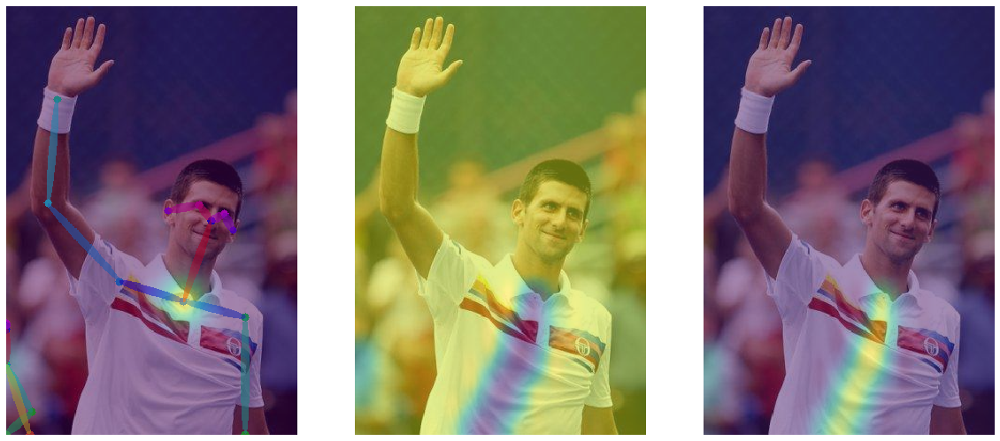

In [47]:
test_image = 'images/demo.jpg'


def plot_part(img , heatmap, index, ax=plt, title=None, alpha = 0.5):
    ax.imshow(img[:, :, [2, 1, 0]])
    ax.imshow(heatmap[0, :, :, index], alpha=alpha)
    ax.axis('off')
    if title:
        ax.set_title(title)

def estimate_plot(filename):
    objtohighlight = part["neck"]
    oriImg = cv2.imread(filename)  # B,G,R order
    candidate, subset, pafs, pcms = body_estimation(oriImg)
    canvas = copy.deepcopy(oriImg)
    canvas = util.draw_bodypose(canvas, candidate, subset)

    fig, axes = plt.subplots(nrows=1, ncols=3, figsize=(20, 10))
    plot_part(canvas, pcms, objtohighlight, axes[0])
    plot_part(oriImg, pafs, 0, axes[1])
    plot_part(oriImg, pafs, 1, axes[2])
    plt.show()
    return pafs, pcms


pafs, pcms = estimate_plot(test_image)

In [16]:
#TODO

In [7]:
pafs.shape

(1, 458, 310, 38)

In [18]:
pcms.shape

(1, 458, 310, 19)

## 11.2 Investigate on wrong detection

Now that you have your brand new tools we have we have six images in a folder "images/weirdos_filtered" this images suffer of wrong classifications for obvious reasons. Try for each one to say at which point in the algorythm the things get wrongs based on your heatmaps. If you have ideas of tools to investigate do not hesitate, we would take it in account ;)

In [ ]:
parts_inversed = {v: k for k , v in part.items()}

def process_image(filename):
    oriImg = cv2.imread(filename)  # B,G,R order
    candidate, subset, pafs, pcms = body_estimation(oriImg)
    canvas = copy.deepcopy(oriImg)
    canvas = util.draw_bodypose(canvas, candidate, subset)

    
    print('PCMS')
    fig, axes = plt.subplots(nrows=4, ncols=5, figsize=(20, 10))
    for y in range(4):
        for x in range(5):
            axes[y, x].axis('off')
            val = y * 5 + x
            if val < 19:
                plot_part(canvas, pcms, val, axes[y, x], parts_inversed[val], 0.4)

    
    plt.show()
    print('PAFS')
    fig, axes = plt.subplots(nrows=20, ncols=2, figsize=(20, 70))
    for y in range(20):
        for x in range(2):
            axes[y, x].axis('off')
            val = x * 20 + y
            if val < 38:
                plot_part(oriImg, pafs, val, axes[y, x], val)
    plt.show()

## Image 1:

PCM:
The heat map for the knees and ankles are incorrect. The right knee was incorrectly identified as the fathers shoulder as such the algorithm tried to find a sensible result for the right ankle, which was the fathers wrist.For the left knee the lag identified a random point on the fathers back while the ankle was placed at his hip. This could also be because the childs legs are covered and the algorithm did not include invisible joints/limbs. 
When looking at only the heat map for all points, without the underlying image we saw that the algorithm did find a jumping humanoid figure, but failed to recognise that there were in fact two figures of different sizes ontop of each other.

PAF:
In images 6 and 7 the algorithm could not clearly draw the link between the ankle, knees and hips. The links are muddy, also finding two possible vectors instead of just one correct one. Confirming that in images 11 and 12, it recognised the fathers hip as the boys ankle, making it look disproportionate.

PCMS


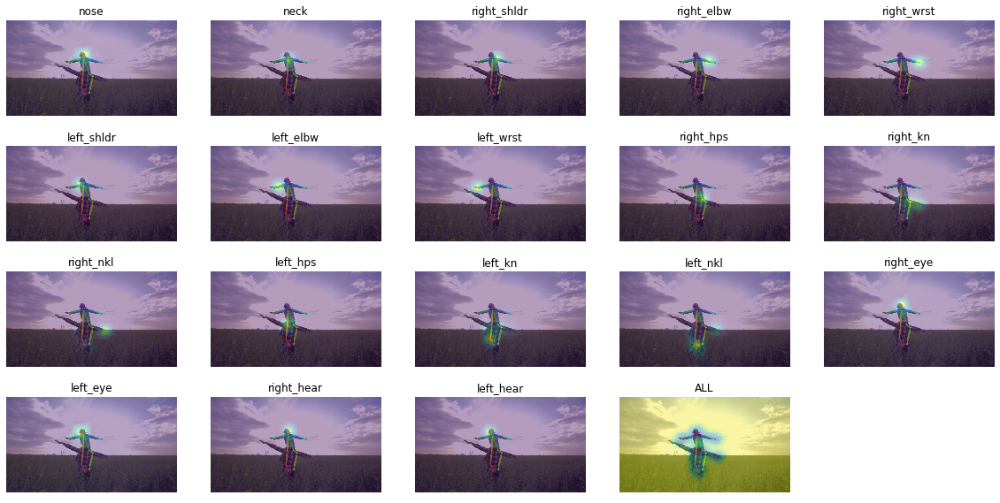

PAFS


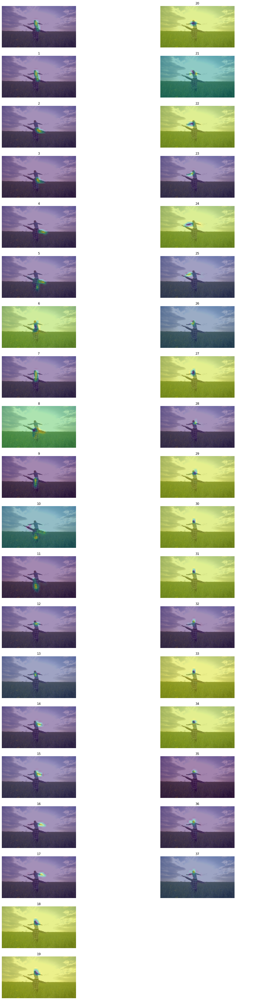

In [64]:
process_image('images/weirdos_filtered/1.jpg')

## Image 2:

Neither the left leg or right arm were recognized. The arm was covered, thus not recognized. The left leg was recognized as the right leg. Probably due to the training data not having such od angles between joints. 

PCMS


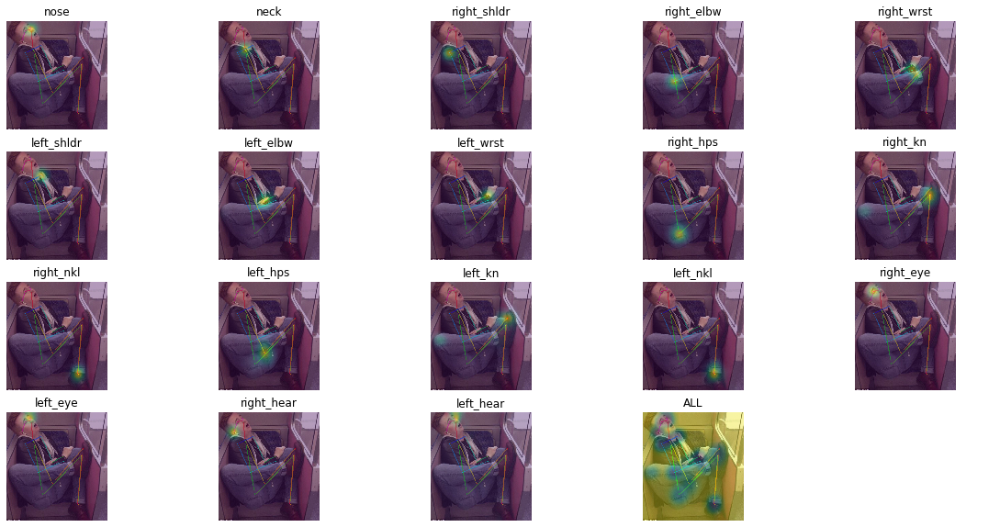

PAFS


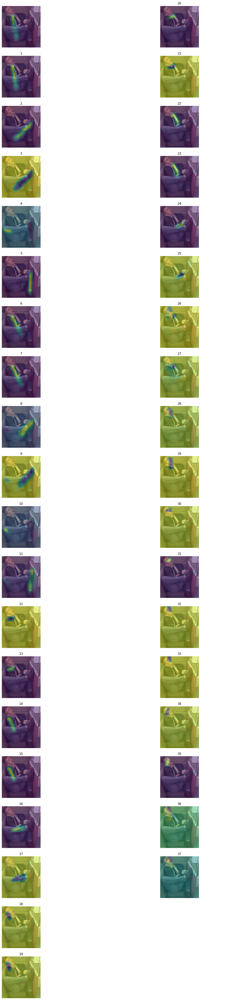

In [68]:
process_image('images/weirdos_filtered/2.jpg')

## Image 3:

The head stand resulted in knee being recognised as the nose, Probably because the algorithm was trained on people standing up, not doing the headstand.

PCMS


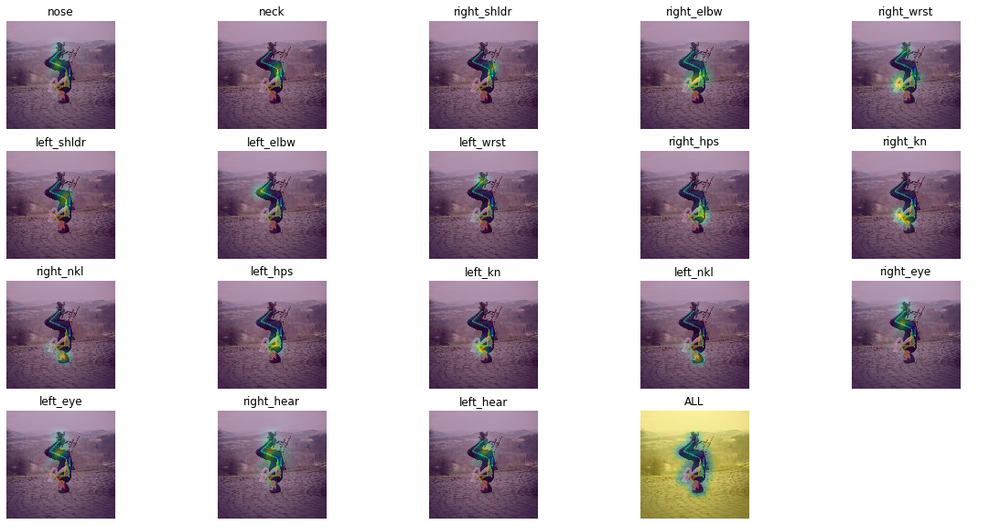

PAFS


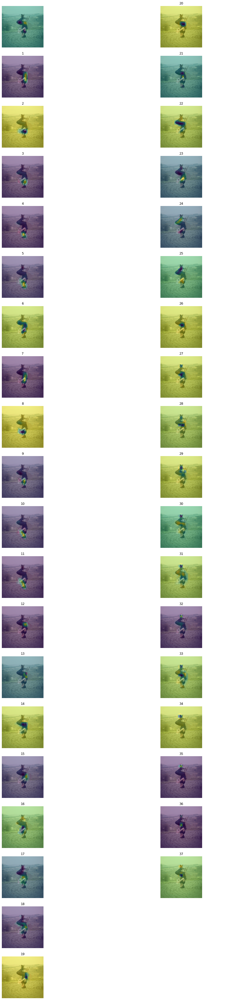

In [69]:
process_image('images/weirdos_filtered/3.jpg')

## Image 4:

The hip joint placement was incorrect identified. This image is of a person more on the sid, as we have seen in the previous images this seems to cause correct identification of the hip joint locations. This could be due to the algortithm being trained on more frontally orientated figures. Additionally the left arm was not found due to it being hidden by the body.

PCMS


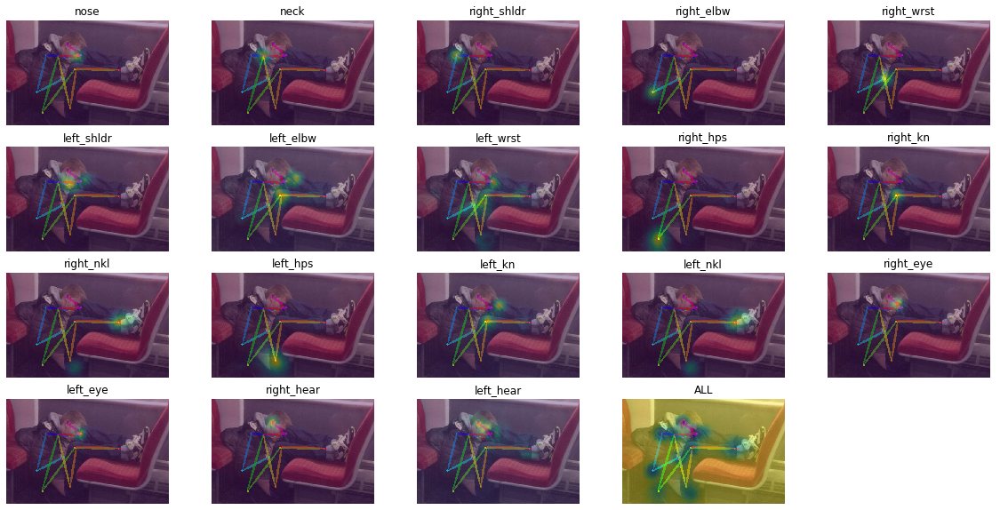

PAFS


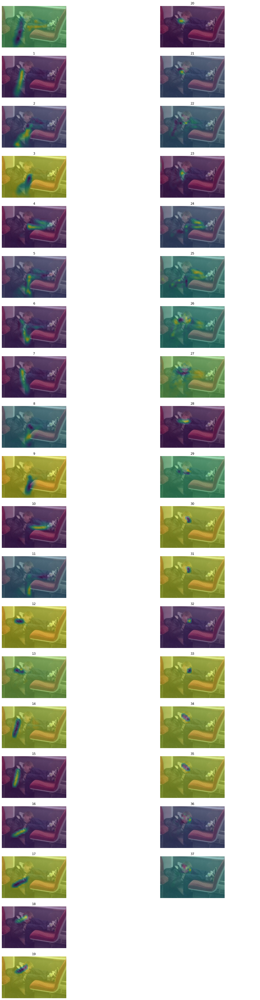

In [70]:
process_image('images/weirdos_filtered/4.jpg')

## Image 5:

Correctly found the hips, but not the legs, one being hidden and the other overlapping the identified neck to hip connection, as well as being partially covered by one of the arms. 
The second arm and leg were, once again, hidden behind the body therefore not found.
So far it seems that leg identification in these odd positions is the most complicated, leading us to think that the training data contained little variation in leg positions.

PCMS


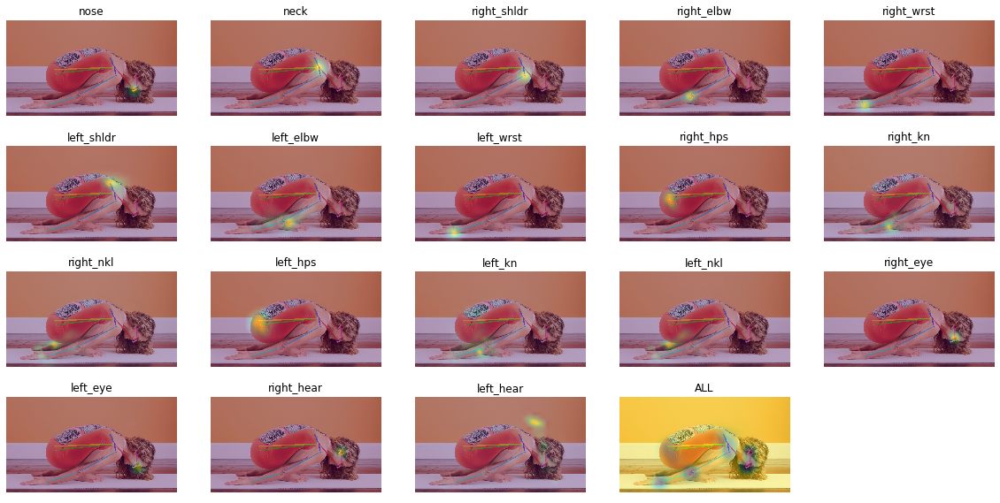

PAFS


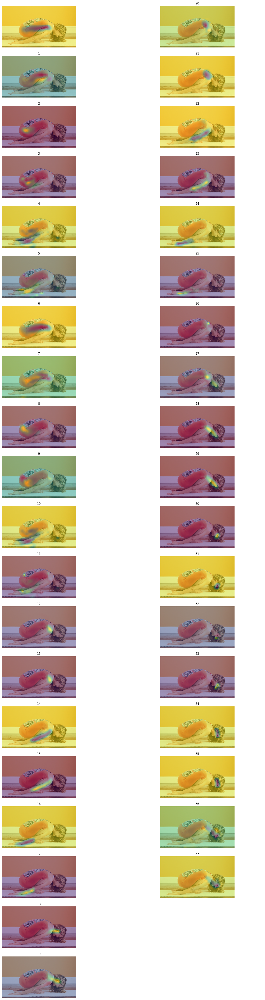

In [71]:
process_image('images/weirdos_filtered/5.jpg')

## Image 6:

This one is the most oddly identified image of the bunch, probably also due to the odd perspective and change in scae of body parts. As such it recognised the tree as a leg, the actual leg as an arm and the second arm as another leg. Basically confusing arms and legs. It overall still recognized a figure of quite normal proportions, however it does not match with the person in the image.


PCMS


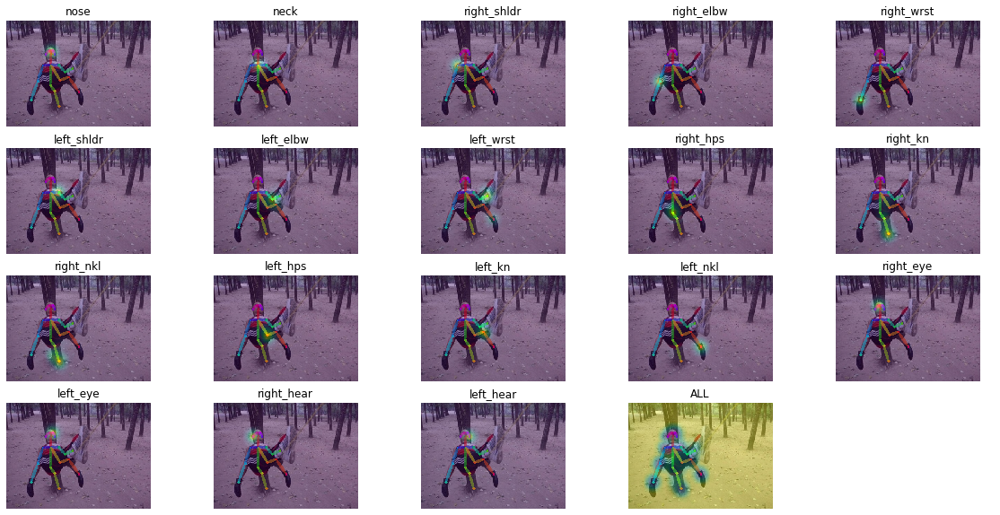

PAFS


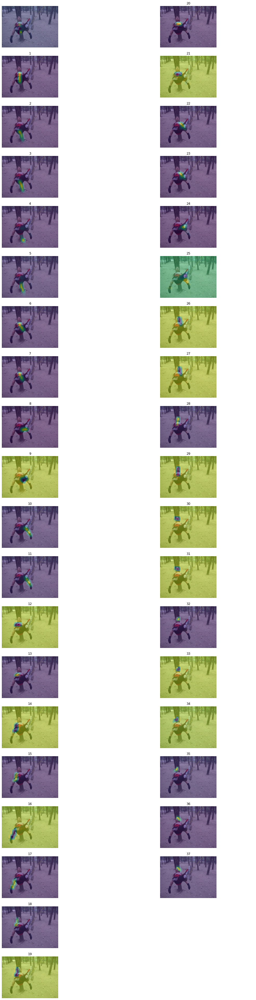

In [72]:
process_image('images/weirdos_filtered/6.jpg')